In [102]:
import warnings
warnings.filterwarnings('ignore')

from datetime import datetime
from distutils.util import strtobool
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

%matplotlib inline

In [103]:
# Функция с Гитхаба
def convert_tsf_to_dataframe(
    full_file_path_and_name,
    replace_missing_vals_with="NaN",
    value_column_name="series_value",
):
    col_names = []
    col_types = []
    all_data = {}
    line_count = 0
    frequency = None
    forecast_horizon = None
    contain_missing_values = None
    contain_equal_length = None
    found_data_tag = False
    found_data_section = False
    started_reading_data_section = False

    with open(full_file_path_and_name, "r", encoding="cp1252") as file:
        for line in file:
            # Strip white space from start/end of line
            line = line.strip()

            if line:
                if line.startswith("@"):  # Read meta-data
                    if not line.startswith("@data"):
                        line_content = line.split(" ")
                        if line.startswith("@attribute"):
                            if (
                                len(line_content) != 3
                            ):  # Attributes have both name and type
                                raise Exception("Invalid meta-data specification.")

                            col_names.append(line_content[1])
                            col_types.append(line_content[2])
                        else:
                            if (
                                len(line_content) != 2
                            ):  # Other meta-data have only values
                                raise Exception("Invalid meta-data specification.")

                            if line.startswith("@frequency"):
                                frequency = line_content[1]
                            elif line.startswith("@horizon"):
                                forecast_horizon = int(line_content[1])
                            elif line.startswith("@missing"):
                                contain_missing_values = bool(
                                    strtobool(line_content[1])
                                )
                            elif line.startswith("@equallength"):
                                contain_equal_length = bool(strtobool(line_content[1]))

                    else:
                        if len(col_names) == 0:
                            raise Exception(
                                "Missing attribute section. Attribute section must come before data."
                            )

                        found_data_tag = True
                elif not line.startswith("#"):
                    if len(col_names) == 0:
                        raise Exception(
                            "Missing attribute section. Attribute section must come before data."
                        )
                    elif not found_data_tag:
                        raise Exception("Missing @data tag.")
                    else:
                        if not started_reading_data_section:
                            started_reading_data_section = True
                            found_data_section = True
                            all_series = []

                            for col in col_names:
                                all_data[col] = []

                        full_info = line.split(":")

                        if len(full_info) != (len(col_names) + 1):
                            raise Exception("Missing attributes/values in series.")

                        series = full_info[len(full_info) - 1]
                        series = series.split(",")

                        if len(series) == 0:
                            raise Exception(
                                "A given series should contains a set of comma separated numeric values. At least one numeric value should be there in a series. Missing values should be indicated with ? symbol"
                            )

                        numeric_series = []

                        for val in series:
                            if val == "?":
                                numeric_series.append(replace_missing_vals_with)
                            else:
                                numeric_series.append(float(val))

                        if numeric_series.count(replace_missing_vals_with) == len(
                            numeric_series
                        ):
                            raise Exception(
                                "All series values are missing. A given series should contains a set of comma separated numeric values. At least one numeric value should be there in a series."
                            )

                        all_series.append(pd.Series(numeric_series).array)

                        for i in range(len(col_names)):
                            att_val = None
                            if col_types[i] == "numeric":
                                att_val = int(full_info[i])
                            elif col_types[i] == "string":
                                att_val = str(full_info[i])
                            elif col_types[i] == "date":
                                att_val = datetime.strptime(
                                    full_info[i], "%Y-%m-%d %H-%M-%S"
                                )
                            else:
                                raise Exception(
                                    "Invalid attribute type."
                                )  # Currently, the code supports only numeric, string and date types. Extend this as required.

                            if att_val is None:
                                raise Exception("Invalid attribute value.")
                            else:
                                all_data[col_names[i]].append(att_val)

                line_count = line_count + 1

        if line_count == 0:
            raise Exception("Empty file.")
        if len(col_names) == 0:
            raise Exception("Missing attribute section.")
        if not found_data_section:
            raise Exception("Missing series information under data section.")

        all_data[value_column_name] = all_series
        loaded_data = pd.DataFrame(all_data)

        return (
            loaded_data,
            frequency,
            forecast_horizon,
            contain_missing_values,
            contain_equal_length,
        )

In [105]:
def cluster_ts(data, n_clusters):

    # Преобразуем список временных рядов в датафрейм
    clustering_data_scaled = pd.DataFrame(data['series_value'].tolist())

    # Масштабируем данные
    ss = StandardScaler()
    clustering_data_scaled = ss.fit_transform(clustering_data_scaled)

    # Кластеризуем TS
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    clusters = kmeans.fit_predict(clustering_data_scaled)

    # Добавляем новый столбец в исходный датафрейм
    data['cluster'] = clusters

    return data

In [106]:
def plot_clustered_series(data, n_clusters, frequency:[str]):
    
    '''
    frequency должна быть как в доке Пандаса:
    https://pandas.pydata.org/docs/user_guide/timeseries.html#timeseries-offset-aliases
    
    В данном случае frequency: 'W' = weekly
    
    '''
    start_date = data['start_timestamp'].min()
    #end_date = data['series_value'].max()

    # Создаём диапазон дат с еженедельной частотой
    date_range = pd.date_range(start=start_date, periods=len(data['series_value'][0]), freq=frequency)

    fig, axs = plt.subplots(n_clusters, 1, figsize=(14, 250))

    # Проходим по всем кластерам
    for i in range(n_clusters):
        # Выбираем данные, относящиеся к текущему кластеру
        cluster_data = data[data['cluster'] == i]
        
        for index, row in cluster_data.iterrows():
            series = row['series_value']
            axs[i].plot(date_range, series)
    
        axs[i].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
        #axs[i].ticklabel_format(style='plain', axis='y')
        axs[i].set_title(f'Кластер {i}')
        axs[i].set_xlabel('Дата')
        axs[i].set_ylabel('Количество')
        axs[i].grid(True)
    
    plt.tight_layout()

    plt.show()

# electricity_weekly_dataset.tsf

In [50]:
file_electricity = 'electricity_weekly_dataset.tsf'
loaded_data, frequency, forecast_horizon, contain_missing_values, contain_equal_length = convert_tsf_to_dataframe(file_electricity)

In [4]:
frequency

'weekly'

In [5]:
forecast_horizon

8

In [6]:
contain_missing_values

False

In [7]:
contain_equal_length

True

In [8]:
loaded_data.head()

,series_name,start_timestamp,series_value
0,T1,2012-01-01,"[8032.0, 9097.0, 9394.0, 8845.0, 5619.0, 3423...."
1,T2,2012-01-01,"[18707.0, 18116.0, 17821.0, 18191.0, 17957.0, ..."
2,T3,2012-01-01,"[11220.0, 15239.0, 9753.0, 20274.0, 29283.0, 3..."
3,T4,2012-01-01,"[83369.0, 81878.0, 83173.0, 80482.0, 86231.0, ..."
4,T5,2012-01-01,"[43956.0, 44750.0, 44668.0, 43102.0, 44661.0, ..."


In [52]:
max(loaded_data['series_value'].apply(len)) # max N points

156

In [10]:
n_clusters = 50
loaded_data_cl = cluster_ts(loaded_data, n_clusters)
loaded_data_cl.head()

,series_name,start_timestamp,series_value,cluster
0,T1,2012-01-01,"[8032.0, 9097.0, 9394.0, 8845.0, 5619.0, 3423....",10
1,T2,2012-01-01,"[18707.0, 18116.0, 17821.0, 18191.0, 17957.0, ...",10
2,T3,2012-01-01,"[11220.0, 15239.0, 9753.0, 20274.0, 29283.0, 3...",10
3,T4,2012-01-01,"[83369.0, 81878.0, 83173.0, 80482.0, 86231.0, ...",47
4,T5,2012-01-01,"[43956.0, 44750.0, 44668.0, 43102.0, 44661.0, ...",44


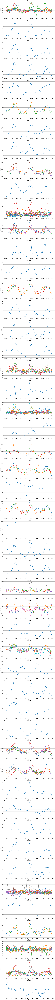

In [15]:
plot_clustered_series(loaded_data_cl, n_clusters, 'W')

# solar_weekly_dataset.tsf

In [95]:
file_solar = 'solar_weekly_dataset.tsf'
loaded_data_solar, frequency_solar, forecast_horizon_solar, contain_missing_values_solar, contain_equal_length_solar = convert_tsf_to_dataframe(file_solar)

In [96]:
loaded_data_solar.head()

,series_name,start_timestamp,series_value
0,T1,2006-01-01,"[8946.9, 10540.6, 8865.65, 10986.9, 8987.1, 12..."
1,T2,2006-01-01,"[4811.25, 4609.2, 3543.5, 4960.55, 4652.2, 634..."
2,T3,2006-01-01,"[3639.9, 4016.05, 3708.3, 4204.85, 4432.55, 42..."
3,T4,2006-01-01,"[4219.2, 4765.4, 3395.6, 4883.65, 4416.25, 558..."
4,T5,2006-01-01,"[8011.05, 7764.95, 6344.8, 9538.9, 8780.8, 110..."


In [97]:
max(loaded_data_solar['series_value'].apply(len)) # max N points

52

In [18]:
frequency_solar

'weekly'

In [19]:
forecast_horizon_solar

5

In [20]:
contain_missing_values_solar

False

In [21]:
contain_equal_length_solar

True

In [23]:
n_clusters = 50
loaded_data_solar_cl = cluster_ts(loaded_data_solar, n_clusters)
loaded_data_solar_cl.head()

,series_name,start_timestamp,series_value,cluster
0,T1,2006-01-01,"[8946.9, 10540.6, 8865.65, 10986.9, 8987.1, 12...",16
1,T2,2006-01-01,"[4811.25, 4609.2, 3543.5, 4960.55, 4652.2, 634...",23
2,T3,2006-01-01,"[3639.9, 4016.05, 3708.3, 4204.85, 4432.55, 42...",33
3,T4,2006-01-01,"[4219.2, 4765.4, 3395.6, 4883.65, 4416.25, 558...",37
4,T5,2006-01-01,"[8011.05, 7764.95, 6344.8, 9538.9, 8780.8, 110...",4


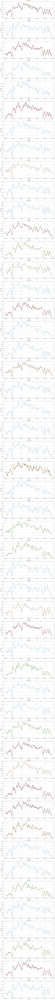

In [24]:
plot_clustered_series(loaded_data_solar_cl, n_clusters, 'W')

# car_parts_dataset_without_missing_values.tsf

In [92]:
file_cars = 'car_parts_dataset_without_missing_values.tsf'
loaded_data_carm, frequency_carm, forecast_horizon_carm, contain_missing_values_carm, contain_equal_length_carm = convert_tsf_to_dataframe(file_cars)

In [93]:
loaded_data_carm

,series_name,start_timestamp,series_value
0,T1,1998-01-01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2.0, 0.0, 0.0, ..."
1,T2,1998-01-01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 2.0, 0.0, ..."
2,T3,1998-01-01,"[0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, ..."
3,T4,1998-01-01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,T5,1998-01-01,"[1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, ..."
...,...,...,...
2669,T2670,1998-01-01,"[6.0, 6.0, 5.0, 0.0, 2.0, 1.0, 3.0, 1.0, 5.0, ..."
2670,T2671,1998-01-01,"[6.0, 5.0, 5.0, 3.0, 5.0, 0.0, 2.0, 1.0, 3.0, ..."
2671,T2672,1998-01-01,"[11.0, 2.0, 0.0, 2.0, 12.0, 0.0, 0.0, 4.0, 2.0..."
2672,T2673,1998-01-01,"[0.0, 0.0, 0.0, 2.0, 1.0, 0.0, 2.0, 4.0, 2.0, ..."


In [94]:
max(loaded_data_carm['series_value'].apply(len)) # max N points

51

In [26]:
frequency_carm

'monthly'

In [27]:
contain_missing_values_carm

False

In [28]:
contain_equal_length_carm

True

In [29]:
n_clusters = 100
loaded_data_carm_cl = cluster_ts(loaded_data_carm, n_clusters)
loaded_data_carm_cl.head()

,series_name,start_timestamp,series_value,cluster
0,T1,1998-01-01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2.0, 0.0, 0.0, ...",38
1,T2,1998-01-01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 2.0, 0.0, ...",1
2,T3,1998-01-01,"[0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, ...",38
3,T4,1998-01-01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",38
4,T5,1998-01-01,"[1.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, ...",38


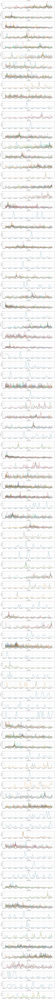

In [30]:
plot_clustered_series(loaded_data_carm_cl, n_clusters, 'M')

# australian_electricity_demand_dataset.tsf

In [31]:
file_au_elec = 'australian_electricity_demand_dataset.tsf'
loaded_data_au_elec, frequency_au_elec, forecast_horizon_au_elec, contain_missing_values_au_elec, contain_equal_length_au_elec = convert_tsf_to_dataframe(file_au_elec)

In [32]:
loaded_data_au_elec

,series_name,state,start_timestamp,series_value
0,T1,NSW,2002-01-01,"[5714.045004, 5360.189078, 5014.835118, 4602.7..."
1,T2,VIC,2002-01-01,"[3535.867064, 3383.499028, 3655.527552, 3510.4..."
2,T3,QUN,2002-01-01,"[3382.041342, 3288.315794, 3172.329022, 3020.3..."
3,T4,SA,2002-01-01,"[1191.078014, 1219.589472, 1119.173498, 1016.4..."
4,T5,TAS,2002-01-01,"[315.915504, 306.245864, 305.762576, 295.60219..."


In [33]:
for i in loaded_data_au_elec['series_value']:
    print(len(i)) # разные длины ряда

230736
230736
232272
230784
230736


In [34]:
frequency_au_elec

'half_hourly'

In [35]:
forecast_horizon_au_elec

In [36]:
contain_missing_values_au_elec

False

In [37]:
contain_equal_length_au_elec

False

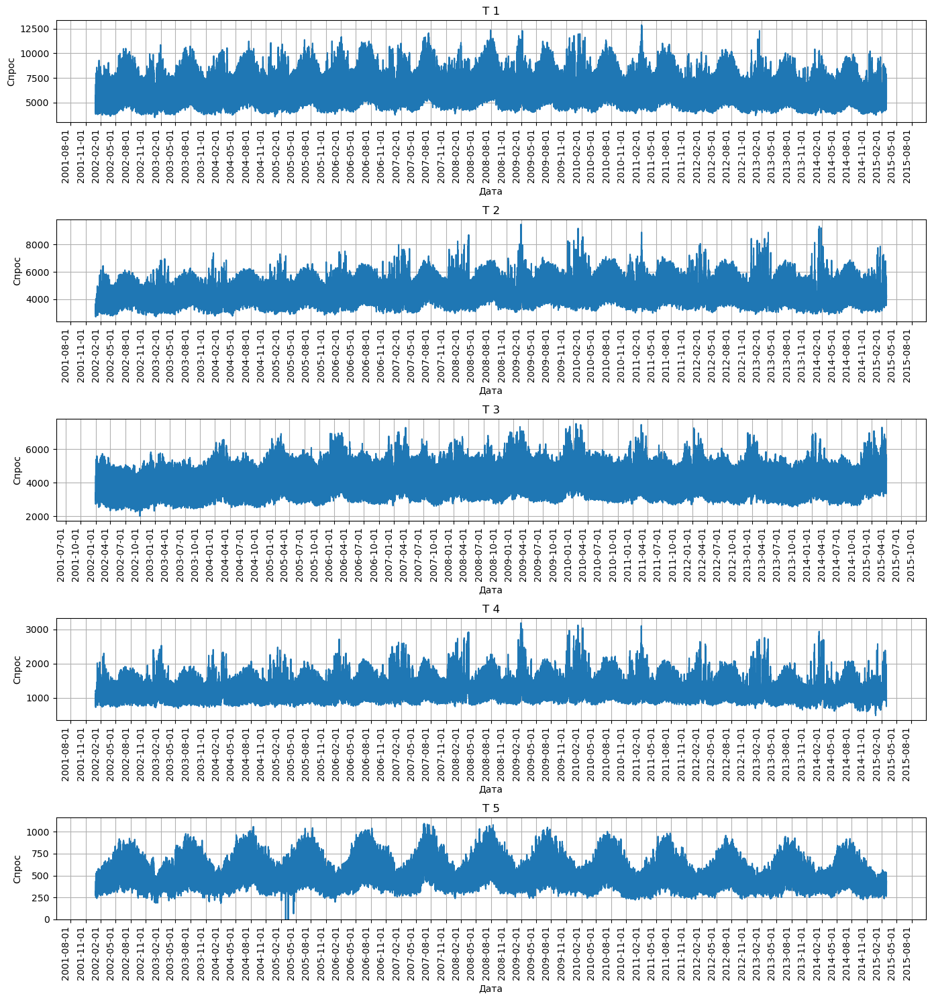

In [39]:
fig, axes = plt.subplots(len(loaded_data_au_elec['series_value']), 1, figsize=(14, 15))

for i, series in enumerate(loaded_data_au_elec['series_value']):

    date_range = pd.date_range(start='2002-01-01', periods=len(series), freq='30T')
    
    axes[i].xaxis.set_major_locator(mdates.MonthLocator(interval=3))
    axes[i].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    plt.setp(axes[i].get_xticklabels(), rotation=90, ha='right')
    axes[i].plot(date_range, series)
    axes[i].set_title(f'T {i+1}')
    axes[i].set_xlabel('Дата')
    axes[i].set_ylabel('Спрос')
    axes[i].grid(True)

plt.tight_layout()
plt.ylim(0)
plt.show()

# solar_10_minutes_dataset.tsf

In [87]:
file_solar10m = 'solar_10_minutes_dataset.tsf'
loaded_data_solar10m, frequency_solar10m, forecast_horizon_solar10m, contain_missing_values_solar10m, contain_equal_length_solar10m = convert_tsf_to_dataframe(file_solar10m)

In [108]:
loaded_data_solar10m.head()

,series_name,start_timestamp,series_value
0,T1,2006-01-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,T2,2006-01-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,T3,2006-01-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,T4,2006-01-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,T5,2006-01-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [90]:
max(loaded_data_solar10m['series_value'].apply(len)) # max N points

52560

In [42]:
frequency_solar10m

'10_minutes'

In [43]:
forecast_horizon_solar10m

In [44]:
contain_missing_values_solar10m

False

In [45]:
contain_equal_length_solar10m

True

In [46]:
n_clusters = 20
loaded_data_solar10m_cl = cluster_ts(loaded_data_solar10m, n_clusters)
loaded_data_solar10m_cl.head()

,series_name,start_timestamp,series_value,cluster
0,T1,2006-01-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",6
1,T2,2006-01-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",15
2,T3,2006-01-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",8
3,T4,2006-01-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0
4,T5,2006-01-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",5


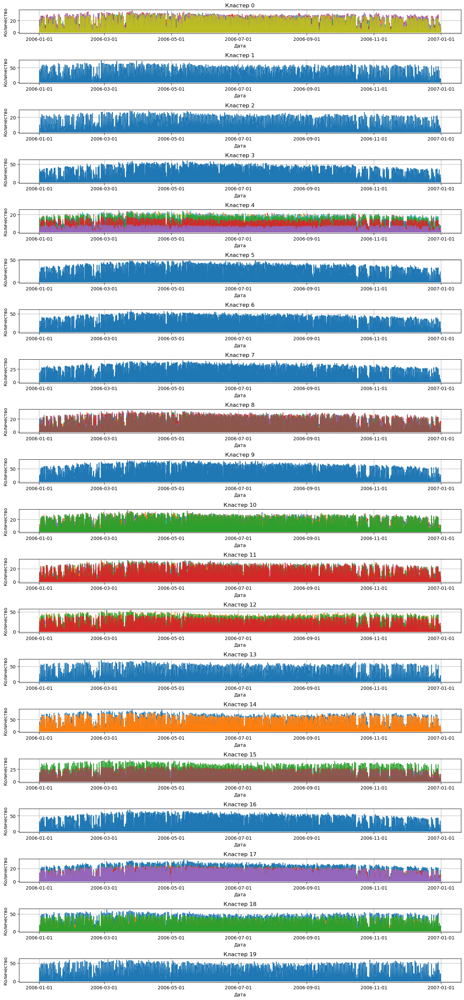

In [51]:
plot_clustered_series(loaded_data_solar10m_cl, n_clusters, '10T')

# solar_4_seconds_dataset.tsf

In [84]:
file_solar4sec = 'solar_4_seconds_dataset.tsf'
loaded_data_solar4sec, frequency_solar4sec, forecast_horizon_solar4sec, contain_missing_values_solar4sec, contain_equal_length_solar4sec = convert_tsf_to_dataframe(file_solar4sec)

In [85]:
loaded_data_solar4sec

,series_name,start_timestamp,series_value
0,T1,2019-08-01 00:00:03,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [86]:
max(loaded_data_solar4sec['series_value'].apply(len))

7397222

In [55]:
frequency_solar4sec

'4_seconds'

In [56]:
forecast_horizon_solar4sec

In [57]:
contain_missing_values_solar4sec

False

In [58]:
contain_equal_length_solar4sec

True

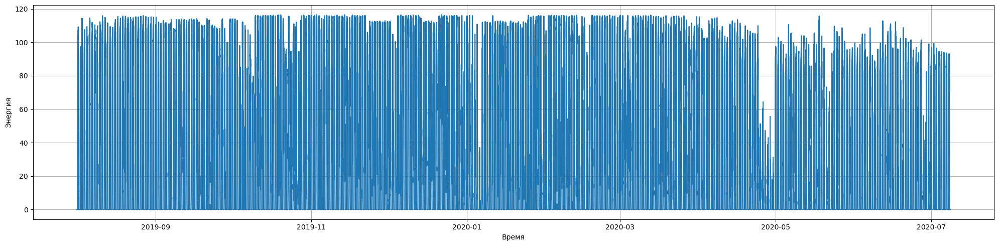

In [93]:
fig, axes = plt.subplots(1, 1, figsize=(20, 5))

date_range_sol = pd.date_range(start='2019-08-01 00:00:03', periods=len(loaded_data_solar4sec['series_value'][0]), freq='4S')
    
#axes.xaxis.set_major_locator(mdates.SecondLocator(interval=36000))
#axes.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M:%S'))
#plt.setp(axes.get_xticklabels(), rotation=45, ha='right')
axes.plot(date_range_sol, loaded_data_solar4sec['series_value'][0])
axes.set_xlabel('Время')
axes.set_ylabel('Энергия')
axes.grid(True)

plt.tight_layout()
#plt.ylim(0)
plt.show()

# wind_4_seconds_dataset.tsf

In [53]:
file_wind = 'wind_4_seconds_dataset.tsf'
loaded_data_w, frequency_w, forecast_horizon_w, contain_missing_values_w, contain_equal_length_w = convert_tsf_to_dataframe(file_wind)

In [54]:
loaded_data_w

,series_name,start_timestamp,series_value
0,T1,2019-08-01 00:00:03,"[18.6, 18.6, 18.6, 18.6, 18.6, 18.6, 18.6, 19...."


In [55]:
max(loaded_data_w['series_value'].apply(len)) # max N points

7397147

In [99]:
frequency_w

'4_seconds'

In [101]:
contain_missing_values_w

False

In [102]:
contain_equal_length_w

True

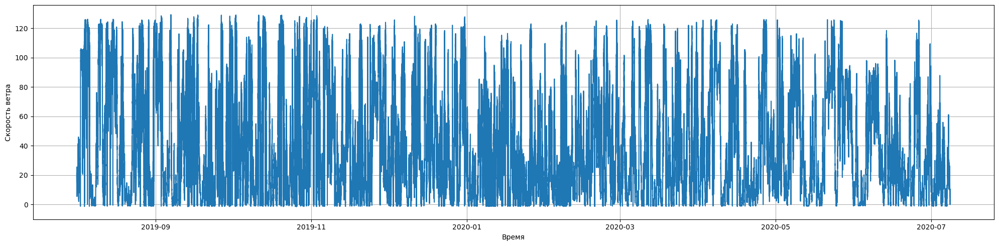

In [66]:
fig, axes = plt.subplots(1, 1, figsize=(20, 5))

date_range_w = pd.date_range(start='2019-08-01 00:00:03', periods=len(loaded_data_w['series_value'][0]),freq='4S')

axes.plot(date_range_w, loaded_data_w['series_value'][0])
axes.set_xlabel('Время')
axes.set_ylabel('Скорость ветра')
axes.grid(True)

plt.tight_layout()
#plt.ylim(-10)
plt.show()

# electricity_hourly_dataset.tsf

In [47]:
file_el_h = 'electricity_hourly_dataset.tsf'
loaded_data_elh, frequency_elh, forecast_horizon_elh, contain_missing_values_elh, contain_equal_length_elh = convert_tsf_to_dataframe(file_el_h)

In [107]:
loaded_data_elh.head()

,series_name,start_timestamp,series_value
0,T1,2012-01-01 00:00:01,"[14.0, 18.0, 21.0, 20.0, 22.0, 20.0, 20.0, 20...."
1,T2,2012-01-01 00:00:01,"[69.0, 92.0, 96.0, 92.0, 91.0, 92.0, 91.0, 92...."
2,T3,2012-01-01 00:00:01,"[234.0, 312.0, 312.0, 312.0, 312.0, 187.0, 138..."
3,T4,2012-01-01 00:00:01,"[415.0, 556.0, 560.0, 443.0, 346.0, 340.0, 376..."
4,T5,2012-01-01 00:00:01,"[215.0, 292.0, 272.0, 213.0, 190.0, 178.0, 199..."


In [110]:
frequency_elh

'hourly'

In [111]:
forecast_horizon_elh

In [112]:
contain_missing_values_elh

False

In [113]:
contain_equal_length_elh

True

In [49]:
max(loaded_data_elh['series_value'].apply(len)) # max N points

26304

In [114]:
n_clusters = 50
loaded_data_elh_cl = cluster_ts(loaded_data_elh, n_clusters)
loaded_data_elh_cl.head()

,series_name,start_timestamp,series_value,cluster
0,T1,2012-01-01 00:00:01,"[14.0, 18.0, 21.0, 20.0, 22.0, 20.0, 20.0, 20....",5
1,T2,2012-01-01 00:00:01,"[69.0, 92.0, 96.0, 92.0, 91.0, 92.0, 91.0, 92....",5
2,T3,2012-01-01 00:00:01,"[234.0, 312.0, 312.0, 312.0, 312.0, 187.0, 138...",5
3,T4,2012-01-01 00:00:01,"[415.0, 556.0, 560.0, 443.0, 346.0, 340.0, 376...",30
4,T5,2012-01-01 00:00:01,"[215.0, 292.0, 272.0, 213.0, 190.0, 178.0, 199...",5


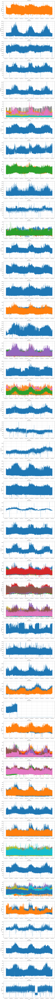

In [117]:
plot_clustered_series(loaded_data_elh_cl, n_clusters, 'H')

# dominick_dataset.tsf ???

In [8]:
file_dom = 'dominick_dataset.tsf'
loaded_data_dom, frequency_dom, forecast_horizon_dom, contain_missing_values_dom, contain_equal_length_dom = convert_tsf_to_dataframe(file_dom)

In [9]:
loaded_data_dom

,series_name,series_value
0,T1,"[41.83, 0.0, 0.0, 0.0, 41.83, 0.0, 0.0, 0.0, 0..."
1,T2,"[68.85, 68.85, 0.0, 68.85, 0.0, 68.85, 0.0, 0...."
2,T3,"[0.0, 0.0, 0.0, 62.62, 62.62, 62.62, 0.0, 62.6..."
3,T4,"[67.99, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0..."
4,T5,"[0.0, 0.0, 0.0, 62.58, 62.58, 0.0, 0.0, 62.58,..."
...,...,...
115699,T115700,"[0.0, 27.47, 33.54, 33.54, 33.56, 33.67, 33.67..."
115700,T115701,"[0.0, 26.31, 31.49, 33.67, 33.67, 33.67, 33.67..."
115701,T115702,"[0.0, 26.54, 33.26, 33.26, 33.26, 33.67, 33.67..."
115702,T115703,"[0.0, 27.39, 31.48, 33.21, 33.38, 33.67, 33.67..."


In [10]:
frequency_dom

'weekly'

In [11]:
forecast_horizon_dom

In [12]:
contain_missing_values_dom

False

In [13]:
contain_equal_length_dom

False

# wind_farms_minutely_dataset_without_missing_values.tsf

In [5]:
file_wm = 'wind_farms_minutely_dataset_without_missing_values.tsf'
loaded_data_wm, frequency_wm, forecast_horizon_wm, contain_missing_values_wm, contain_equal_length_wm = convert_tsf_to_dataframe(file_wm)

In [109]:
loaded_data_wm.head()

,series_name,start_timestamp,series_value,cluster
0,T1,2019-08-01 00:00:01,"[559.0, 560.0, 559.0, 558.0, 559.0, 558.0, 559...",6
1,T2,2019-08-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",19
2,T3,2019-08-01 00:00:01,"[559.0, 561.0, 560.0, 559.0, 559.0, 560.0, 560...",12
3,T4,2019-08-01 00:00:01,"[540.0, 541.0, 540.0, 539.0, 539.0, 540.0, 540...",15
4,T5,2019-08-01 00:00:01,"[539.1, 539.5, 538.7, 539.1, 538.7, 538.7, 539...",37


In [8]:
frequency_wm

'minutely'

In [9]:
forecast_horizon_wm

In [10]:
contain_missing_values_wm

False

In [11]:
contain_equal_length_wm

False

In [12]:
max_length = max(loaded_data_wm['series_value'].apply(len)) # max N points
max_length

527040

In [13]:
min_length = min(loaded_data_wm['series_value'].apply(len)) # min N points
min_length

6345

In [110]:
def pad_time_series(df, series_column):
    max_length = max(df[series_column].apply(len))
    def pad_series(series):
        return np.pad(series, (0, max_length - len(series)), 'constant', constant_values=0)
    df[series_column] = df[series_column].apply(pad_series)
    return df

padded_df = pad_time_series(loaded_data_wm, 'series_value')
padded_df.head()

,series_name,start_timestamp,series_value,cluster
0,T1,2019-08-01 00:00:01,"[559.0, 560.0, 559.0, 558.0, 559.0, 558.0, 559...",6
1,T2,2019-08-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",19
2,T3,2019-08-01 00:00:01,"[559.0, 561.0, 560.0, 559.0, 559.0, 560.0, 560...",12
3,T4,2019-08-01 00:00:01,"[540.0, 541.0, 540.0, 539.0, 539.0, 540.0, 540...",15
4,T5,2019-08-01 00:00:01,"[539.1, 539.5, 538.7, 539.1, 538.7, 538.7, 539...",37


In [18]:
n_clusters = 50
loaded_data_wm_cl = cluster_ts(padded_df, n_clusters)
loaded_data_wm_cl.head()

,series_name,start_timestamp,series_value,cluster
0,T1,2019-08-01 00:00:01,"[559.0, 560.0, 559.0, 558.0, 559.0, 558.0, 559...",6
1,T2,2019-08-01 00:00:01,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",19
2,T3,2019-08-01 00:00:01,"[559.0, 561.0, 560.0, 559.0, 559.0, 560.0, 560...",12
3,T4,2019-08-01 00:00:01,"[540.0, 541.0, 540.0, 539.0, 539.0, 540.0, 540...",15
4,T5,2019-08-01 00:00:01,"[539.1, 539.5, 538.7, 539.1, 538.7, 538.7, 539...",37


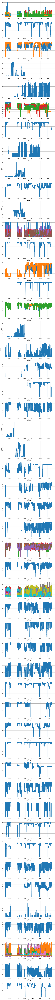

In [22]:
plot_clustered_series(loaded_data_wm_cl, n_clusters, '1T')

# london_smart_meters_dataset_without_missing_values.tsf

In [43]:
file_london = 'london_smart_meters_dataset_without_missing_values.tsf'
loaded_data_london, frequency_london, forecast_horizon_london, contain_missing_values_london, contain_equal_length_london = convert_tsf_to_dataframe(file_london)

In [111]:
loaded_data_london.head()

,series_name,start_timestamp,series_value
0,T1,2012-10-13 00:00:01,"[0.263, 0.269, 0.275, 0.256, 0.211, 0.136, 0.1..."
1,T2,2011-12-04 00:00:01,"[0.175, 0.098, 0.144, 0.065, 0.071, 0.037, 0.0..."
2,T3,2012-03-23 00:00:01,"[1.337, 1.426, 0.996, 0.971, 0.994, 0.952, 0.8..."
3,T4,2012-05-09 00:00:01,"[0.18, 0.086, 0.106, 0.173, 0.146, 0.223, 0.21..."
4,T5,2012-09-18 00:00:01,"[0.076, 0.079, 0.123, 0.109, 0.051, 0.069, 0.0..."


In [46]:
max(loaded_data_london['series_value'].apply(len)) # max N points

39648

In [25]:
frequency_london

'half_hourly'

In [26]:
forecast_horizon_london

In [27]:
contain_missing_values_london

False

In [28]:
contain_equal_length_london

False

In [29]:
padded_london = pad_time_series(loaded_data_london, 'series_value')
padded_london.head()

,series_name,start_timestamp,series_value
0,T1,2012-10-13 00:00:01,"[0.263, 0.269, 0.275, 0.256, 0.211, 0.136, 0.1..."
1,T2,2011-12-04 00:00:01,"[0.175, 0.098, 0.144, 0.065, 0.071, 0.037, 0.0..."
2,T3,2012-03-23 00:00:01,"[1.337, 1.426, 0.996, 0.971, 0.994, 0.952, 0.8..."
3,T4,2012-05-09 00:00:01,"[0.18, 0.086, 0.106, 0.173, 0.146, 0.223, 0.21..."
4,T5,2012-09-18 00:00:01,"[0.076, 0.079, 0.123, 0.109, 0.051, 0.069, 0.0..."


In [32]:
n_clusters = 100
loaded_data_london_cl = cluster_ts(padded_london, n_clusters)
loaded_data_london_cl.head()

,series_name,start_timestamp,series_value,cluster
0,T1,2012-10-13 00:00:01,"[0.263, 0.269, 0.275, 0.256, 0.211, 0.136, 0.1...",88
1,T2,2011-12-04 00:00:01,"[0.175, 0.098, 0.144, 0.065, 0.071, 0.037, 0.0...",61
2,T3,2012-03-23 00:00:01,"[1.337, 1.426, 0.996, 0.971, 0.994, 0.952, 0.8...",91
3,T4,2012-05-09 00:00:01,"[0.18, 0.086, 0.106, 0.173, 0.146, 0.223, 0.21...",27
4,T5,2012-09-18 00:00:01,"[0.076, 0.079, 0.123, 0.109, 0.051, 0.069, 0.0...",86


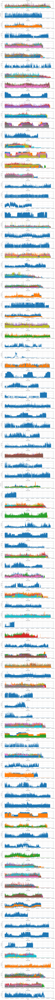

In [33]:
plot_clustered_series(loaded_data_london_cl, n_clusters, '30T')